In [1]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
from pyproj import Proj, CRS, Transformer
from mpl_toolkits.axes_grid1 import make_axes_locatable
import torch
import gpytorch
import rasterio
import tqdm

base_dir = os.path.join(os.getcwd(), '..')
sys.path.append(base_dir)

from src.kernels import CMEAggregateKernel
from src.means import CMEAggregateMean
from src.models import ExactCMEProcess
from src.structures import BagDataset

def list_collate(batch):
    data, target = zip(*batch)
    return list(data), torch.Tensor(target)

def process(array, qmin=1, qmax=99):
    normalize = lambda x: (x - x.min(axis=(0, 1))) / (x.max(axis=(0, 1)) - x.min(axis=(0, 1)))
    upper_bound = np.percentile(array, q=qmax, axis=(0, 1))
    lower_bound = np.percentile(array, q=qmin, axis=(0, 1))
    array = array.clip(min=lower_bound, max=upper_bound)
    array = normalize(array)
    return array

### Load and visualize bag dataset

In [2]:
# Load aerobag dataframe
df_path = '../../aerobag-dataset/sandbox/aerobag-01-04-20.csv'
df = pd.read_csv(df_path, index_col='index')

df.sample(n=5)

,Unnamed: 0,MODIS_Longitude(Degree),MODIS_Latitude(Degree),b01,b02,b03,b04,b05,b06,b07,...,SolarZenith,AERONET_Site_Name,AERONET_Instrument_Number,Day_of_Year,Data_Quality_Level,Site_Longitude(Degrees),Site_Latitude(Degrees),Site_Elevation(m),AOD_500nm,bag_index
index,,,,,,,,,,,,,,,,,,,,,
445,5872,-4.424364,48.366087,736.0,2346.0,338.0,644.0,2811.0,2395.0,1691.0,...,4420.0,Brest_MF,46,92,lev20,-4.411855,48.444565,101.0,0.217799,14
323,5750,-4.453693,48.557753,513.0,3669.0,193.0,580.0,3514.0,2288.0,1118.0,...,4425.0,Brest_MF,46,92,lev20,-4.411855,48.444565,101.0,0.217799,14
194,4121,26.659605,58.186121,479.0,1264.0,217.0,370.0,1652.0,1431.0,870.0,...,5337.0,Toravere,128,92,lev20,26.466823,58.264895,85.0,0.072464,11
27,12731,-5.299999,50.380953,605.0,3357.0,595.0,691.0,3307.0,2015.0,927.0,...,4608.0,Camborne_MO,849,92,lev20,-5.326560,50.217820,87.0,0.112448,30
140,4567,2.114663,48.583113,744.0,1552.0,533.0,715.0,1589.0,1430.0,1090.0,...,4398.0,Palaiseau,1044,92,lev20,2.215000,48.711600,156.0,0.111697,12


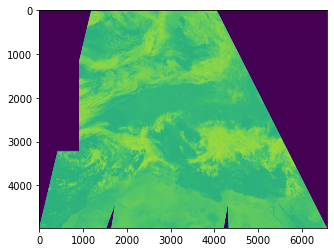

In [3]:
# Load raster
raster = rasterio.open('../../aerobag-dataset/sandbox/MODIS.tif')
b01 = raster.read(1)
plt.imshow(b01)
plt.show()

In [4]:
# Get sites and bags coordinates
WGS84 = rasterio.crs.CRS.from_epsg(4326)
wgs84_to_raster_crs = Transformer.from_proj(WGS84, raster.crs, always_xy=True).transform
to_pixel = lambda row: ~raster.transform * wgs84_to_raster_crs(row[0], row[1])


sites_df = df[['Site_Longitude(Degrees)', 'Site_Latitude(Degrees)']].drop_duplicates()
bags_df = df[['MODIS_Longitude(Degree)', 'MODIS_Latitude(Degree)']]

sites_pixels = sites_df.apply(to_pixel, axis=1).values
sites_pixels = np.asarray(list(map(list, sites_pixels)))

bags_pixels = bags_df.apply(to_pixel, axis=1).values
bags_pixels = np.asarray(list(map(list, bags_pixels)))

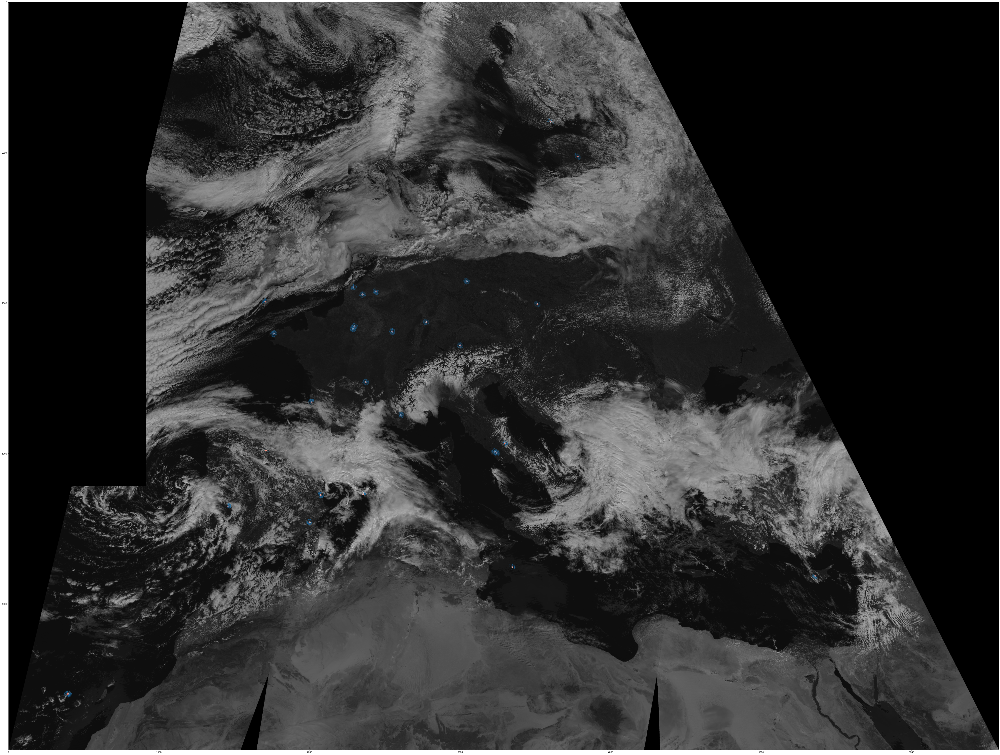

In [73]:
fig, ax = plt.subplots(1, 1, figsize=(64, 64))

ax.imshow(b01.clip(min=-1000), cmap='gray')
ax.scatter(*sites_pixels.T, c='tomato', marker='D', edgecolors='white')
ax.scatter(*bags_pixels.T, s=0.1, alpha=0.5)

plt.tight_layout()
plt.show()

### Preprocess data

- Normalize
- Filter out columns

In [5]:
# Normalize
norm_df = (df - df.mean()) / df.std()

In [6]:
# Select features of interest to keep in dataset
individuals_columns = ['MODIS_Longitude(Degree)', 'MODIS_Latitude(Degree)',
                       'b01', 'b02', 'b03', 'b04', 'b05', 'b06', 'b07', 'SensorAzimuth',
                       'SensorZenith', 'SolarAzimuth', 'SolarZenith']
bags_columns = ['Site_Longitude(Degrees)', 'Site_Latitude(Degrees)']
augmented_columns = individuals_columns + bags_columns

# Compute number of bags and their respective sizes
n_bags = df['bag_index'].max()
bags_sizes = df.groupby('bag_index').count()['AOD_500nm'].values

# Extract individuals (augmented with bags values) and aggregate targets
individuals = [norm_df[df.bag_index == idx][augmented_columns].values for idx in df.bag_index.unique()]
aggregate_targets = norm_df.AOD_500nm.drop_duplicates().values

# Instantiate bag dataset
dataset = BagDataset(bags=individuals, labels=aggregate_targets)
dataset

Number of bags : 29 
Dimensionality : 15 
Number of individuals : 13204 
Data type : float64

### Instantiate CME Process

In [7]:
# Create CME Process
individuals_mean = gpytorch.means.ZeroMean()
individuals_kernel = gpytorch.kernels.LinearKernel(active_dims=torch.arange(13), 
                                                   ard_num_dims=13)
bag_kernel = gpytorch.kernels.LinearKernel(active_dims=torch.arange(2), 
                                           ard_num_dims=2)

In [8]:
individuals_tensors = torch.from_numpy(norm_df[individuals_columns].values).float()
bags_tensor = torch.from_numpy(norm_df[bags_columns].drop_duplicates().values).float()
aggregate_targets_tensor = torch.from_numpy(aggregate_targets).float()


model = ExactCMEProcess(individuals_mean=individuals_mean, 
                        individuals_kernel=individuals_kernel,
                        bag_kernel=bag_kernel,
                        train_individuals=individuals_tensors,
                        train_bags=bags_tensor,
                        train_aggregate_targets=aggregate_targets_tensor,
                        bags_sizes=bags_sizes,
                        lbda=1e-3,
                        likelihood=gpytorch.likelihoods.GaussianLikelihood())

model

ExactCMEProcess(
  (likelihood): GaussianLikelihood(
    (noise_covar): HomoskedasticNoise(
      (raw_noise_constraint): GreaterThan(1.000E-04)
    )
  )
  (individuals_mean): ZeroMean()
  (individuals_kernel): LinearKernel(
    (raw_variance_constraint): Positive()
  )
  (bag_kernel): LinearKernel(
    (raw_variance_constraint): Positive()
  )
  (mean_module): CMEAggregateMean(
    (bag_kernel): LinearKernel(
      (raw_variance_constraint): Positive()
    )
  )
  (covar_module): CMEAggregateKernel(
    (bag_kernel): LinearKernel(
      (raw_variance_constraint): Positive()
    )
  )
)

### Visualize Model prediction on train set

In [17]:
model.eval()

with torch.no_grad():
    train_pred = model.predict(individuals_tensors)
    
mean_pred = train_pred.mean.numpy()

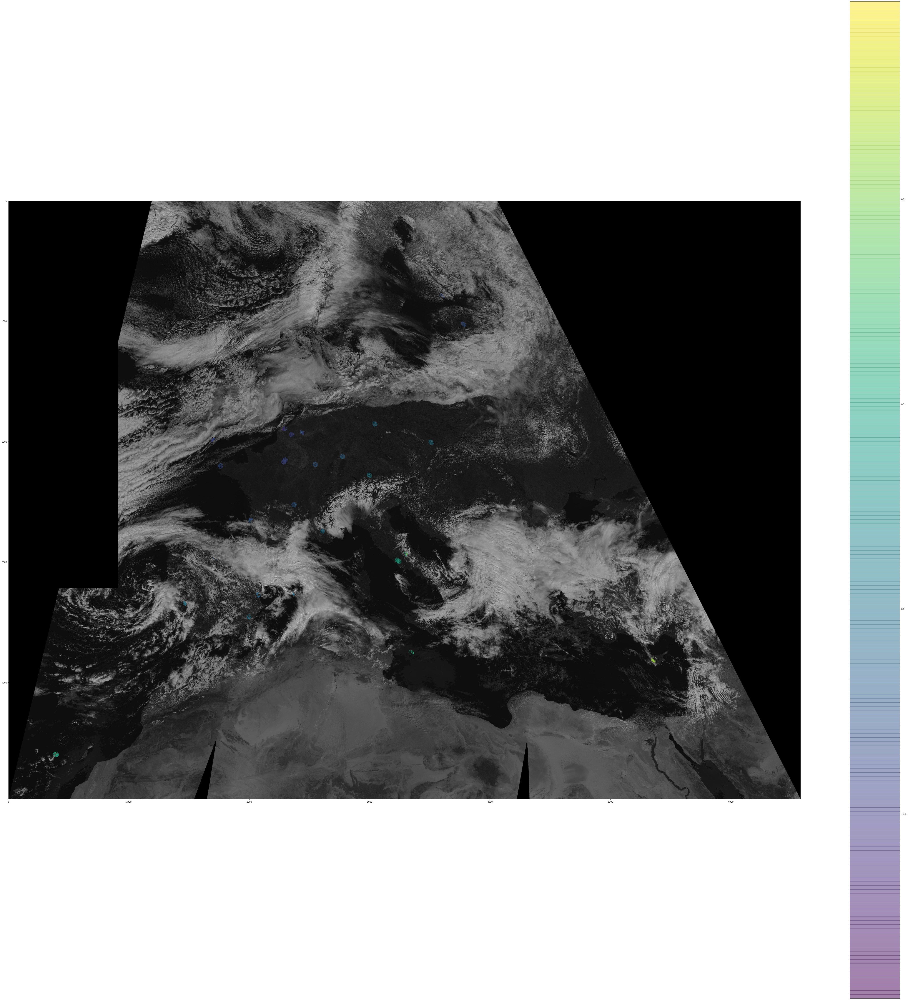

In [18]:
fig, ax = plt.subplots(1, 1, figsize=(64, 64))



ax.imshow(b01.clip(min=-1000), cmap='gray')



norm = matplotlib.colors.Normalize(vmin=mean_pred.min(),
                                   vmax=mean_pred.max())
img = ax.scatter(*bags_pixels.T, c=mean_pred, cmap='viridis', norm=norm, s=0.1, alpha=0.5)
fig.colorbar(img)


plt.tight_layout()
plt.show()

### MLE Estimate of model parameters

In [16]:
epochs = 20
model.train()
optimizer = torch.optim.Adam(params=model.parameters(), lr=0.1)
mll = gpytorch.mlls.ExactMarginalLogLikelihood(model.likelihood, model)

epoch_iter = tqdm.tqdm(range(epochs), desc="Epoch")
for epoch in epoch_iter:
    optimizer.zero_grad()
    output = model(bags_tensor)
    loss = -mll(output, aggregate_targets_tensor)
    loss.backward()
    optimizer.step()
    with torch.no_grad():
        model.update_cme_estimate_parameters()
    epoch_iter.set_postfix(loss=loss.item())

Epoch: 100%|██████████| 20/20 [00:28<00:00,  1.43s/it, loss=1.52]
